In [1]:
import nest_asyncio

nest_asyncio.apply()

In [ ]:
from dotenv import load_dotenv
import os
load_dotenv()

In [4]:
from llama_parse import LlamaParse

In [ ]:
# Access the API key
api_key = os.getenv("LLAMA_CLOUD_API_KEY")

# Print or use the API key
print("Loaded API Key:", api_key)

In [4]:
parser = LlamaParse(
    #api_key="llx-...",  # can also be set in your env as LLAMA_CLOUD_API_KEY
    result_type="markdown",  # "markdown" and "text" are available
    num_workers=4,  # if multiple files passed, split in `num_workers` API calls
    verbose=True,
    language="en",  # Optionally you can define a language, default=en
)

In [ ]:
from pprint import pprint
pprint(parser)

In [ ]:
LlamaParse??

In [ ]:
documents = parser.load_data("./data/scanned-handwritten-document.pdf")

In [ ]:
documents

In [ ]:
pprint(documents)

In [ ]:
documents[0].text_resource.text

## Excel spreadsheet parsing

In [ ]:
documents_excel = parser.load_data("./data/nvidia_quarterly_revenue_trend_by_market.xlsx")
documents_excel

In [ ]:
documents_excel[0].text_resource.text

## Parsing Instructions

Parsing instructions allow you to guide our parsing model in the same way you would instruct an LLM.

These instructions can be useful for improving the parser's performance on complex document layouts, extracting data in a specific format, or transforming the document in other ways.

##### Why This Matters:
Traditional document parsing can be rigid and error-prone, often missing crucial context and nuances in complex layouts. Our instruction-based parsing allows you to:
- Extract specific information with pinpoint accuracy
- Handle complex document layouts with ease
- Transform unstructured data into structured formats effortlessly
- Save hours of manual data entry and verification
- Reduce errors in document processing workflows

In [ ]:
parsing_without_instructions = parser.load_data("./data/purchase_order_document.pdf")

In [ ]:
print(parsing_without_instructions[0].text)

In [ ]:
parsingInstruction = """You are provided with a purchase order. 
Identify the PO number, vendor details, shipping terms, and itemized list of products with quantities and unit prices."""

parsing_with_instructions = LlamaParse(
    #api_key="llx-...",  # can also be set in your env as LLAMA_CLOUD_API_KEY
    parsing_instruction = parsingInstruction,
    result_type="markdown",  # "markdown" and "text" are available
    num_workers=4,  # if multiple files passed, split in `num_workers` API calls
    verbose=True,
    language="en",  # Optionally you can define a language, default=en
).load_data("./data/purchase_order_document.pdf")

In [ ]:
print(parsing_with_instructions[0].text)

## Automode


In [ ]:
parsing_with_automode = LlamaParse(
    result_type="markdown",
    auto_mode = True,
    auto_mode_trigger_on_image_in_page=True,
    auto_mode_trigger_on_table_in_page=True,
    # auto_mode_trigger_on_text_in_page="<text_on_page>"
    # auto_mode_trigger_on_regexp_in_page="<regexp_on_page>"
).load_data("./data/attention-is-all-you-need.pdf")

In [38]:
# create page nodes

from copy import deepcopy
from llama_index.core.schema import TextNode
from llama_index.core import VectorStoreIndex


def get_page_nodes(docs, separator="\n---\n"):
    """Split each document into page node, by separator."""
    nodes = []
    for doc in docs:
        doc_chunks = doc.text.split(separator)
        for doc_chunk in doc_chunks:
            node = TextNode(
                text=doc_chunk,
                metadata=deepcopy(doc.metadata),
            )
            nodes.append(node)

    return nodes

In [41]:
page_nodes = get_page_nodes(parsing_with_automode)

In [ ]:
len(page_nodes)

In [ ]:
print(parsing_with_automode[2].get_content())

In [ ]:
print(parsing_with_automode[7].get_content())

## Specific page number parsing

In [ ]:
parsing_with_automode_with_pagenumber = LlamaParse(
    result_type="markdown",
    auto_mode = True,
    auto_mode_trigger_on_image_in_page=True,
    auto_mode_trigger_on_table_in_page=True,
    target_pages="2,7"
).load_data("./data/attention-is-all-you-need.pdf")

In [ ]:
page_nodes_page_number = get_page_nodes(parsing_with_automode_with_pagenumber)
print(len(page_nodes_page_number))
print(page_nodes_page_number[0].get_content())

[Mermaid Live Editor](https://mermaid.live/edit#pako:eNpVjsFqw0AMRH9F6NRC_AM-FBq7zSWQQnOqnYOwZe-S7GqR14Rg-9-7TlpodZJm3gyasJGWMcfuItfGkEY4lrWHNK9VYdQO0dFwgix7mXccwYnn2wzbp53AYCQE6_vnB79dISim_YoxRGP9eXlYxT1_8DxDWe0pRAmnv87xKjO8VfbDpPr_jlFOqfeqo7yjrCGFgvSO4AYdqyPbpvenVakxGnZcY57WlvRcY-2XxNEY5fPmG8yjjrxBlbE3mAovQ7rG0FLk0lKv5H6RQP5LxP1AyzeJDl_b)

## LlamaParse in JSON mode for PDF Reading

In [55]:
parsing_get_json_result = LlamaParse(
    result_type="markdown",
    premium_mode = True,
)

In [ ]:
json_objects = parsing_get_json_result.get_json_result("./data/scanned-handwritten-document.pdf")

In [ ]:
json_objects

In [ ]:
import json
pprint(list(json_objects[0].keys()))

In [ ]:
# lets check the metadata
metadata = json_objects[0]["job_metadata"]
print(json.dumps(metadata, indent=2))

### Parsing audio files ( with fast mode)

In [ ]:
parsing_audio_file = LlamaParse(
    result_type="text",
    #result_type = "markdown"
    fast_mode = True,
).load_data("./data/llamaparse-audio-test.wav")

In [ ]:
print(parsing_audio_file[0].text)

## [Multimodal](https://docs.cloud.llamaindex.ai/llamaparse/features/multimodal) parsing with Llamaparse
- Code in Github [link](https://github.com/run-llama/llama_parse/blob/main/examples/demo_starter_multimodal.ipynb)
- If you choose to do so LlamaParse will only charge you 1 credit (0.3c) per page.
- more expensive than regular parsing but can get better results for some documents.
- Bring your own model
```
parser = LlamaParse(
  use_vendor_multimodal_model=True
  vendor_multimodal_model_name="openai-gpt4o"
  vendor_multimodal_api_key="sk-proj-xxxxxx"
)
```
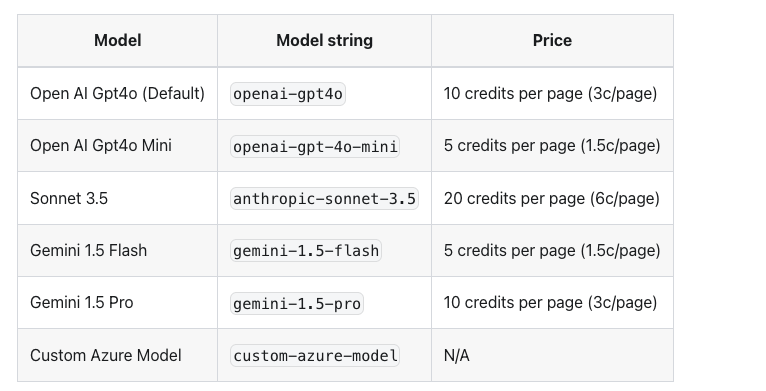

## RAG Example

In [ ]:
#!uv add llama-index-embeddings-ollama llama-index-llms-ollama llama-index-core llama-index llama-index-core

In [18]:
# setup llm
# https://console.groq.com/keys
from llama_index.llms.ollama import Ollama
#from llama_index.llms.groq import Groq

llm = Ollama(model="llama3:latest", request_timeout=120.0)
#llm = Groq(model="llama3-70b-8192")

In [19]:
#setup embedding model
# https://docs.llamaindex.ai/en/stable/examples/embeddings/ollama_embedding/
from llama_index.embeddings.ollama import OllamaEmbedding
#from llama_index.embeddings.huggingface import HuggingFaceEmbedding


embed_model = OllamaEmbedding(model_name="nomic-embed-text:latest")
#embed_model = HuggingFaceEmbedding(model_name="BAAI/bge-small-en-v1.5")

In [20]:
# define global setting
from llama_index.core import Settings

Settings.llm = llm
Settings.embed_model = embed_model

In [ ]:
# building index and QueryEngine
from llama_index.core import VectorStoreIndex

index = VectorStoreIndex.from_documents(documents_excel)

query_engine = index.as_query_engine()

In [ ]:
# querying
response = query_engine.query("What is the total revenue in Q1 FY25?")
print(str(response))

#### Let's encapsulate code into a class to handle different document variables.

In [9]:
from llama_index.embeddings.huggingface import HuggingFaceEmbedding
from llama_index.llms.groq import Groq
from llama_index.core import Settings, VectorStoreIndex

class DocumentQueryEngine:
    def __init__(self, llm_model="llama3-70b-8192", embed_model_name="BAAI/bge-small-en-v1.5", request_timeout=120.0):
        # Setup LLM
        self.llm = Groq(model=llm_model, request_timeout=request_timeout)
        
        # Setup embedding model
        self.embed_model = HuggingFaceEmbedding(model_name=embed_model_name)
        
        # Define global settings
        Settings.llm = self.llm
        Settings.embed_model = self.embed_model
    
    def query_documents(self, documents, query):
        """
        Build the index and query the documents.
        
        Parameters:
            documents: List of Document objects
            query: str - The query string
            
        Returns:
            str - Response to the query
        """
        # Build index and QueryEngine
        index = VectorStoreIndex.from_documents(documents)
        query_engine = index.as_query_engine()
        
        # Querying
        response = query_engine.query(query)
        return str(response)

In [10]:
engine = DocumentQueryEngine()

In [ ]:
response = engine.query_documents(documents_excel, "What is the total revenue in Q1 FY25?")
print(response)

In [ ]:
response = engine.query_documents(documents_scanned_pdf, "What is the age of Ram?")
print(response)

In [ ]:
response = engine.query_documents(parsing_with_automode_with_pagenumber, "What is the BLEU score of ByteNet?")
print(response)

In [ ]:
response = engine.query_documents(parsing_audio_file, "What is the video about?")
print(response)